# A complete brief intro to EBSD processing using SAnTex

This jupyter notebook will demonstrate SAnTex library and the modules available within it. This notebook starts from loading an EBSD data, to getting phases information, to getting the data, and plotting it, to calculation of ODF, PDF and IPF, rotating the EBSD data to match convention, to cleaning EBSD data, and then to the calculation of seismic anisotropy by loading material parameters

# Load the required modules

Firstly, we have to load the required modules from the SAnTex package. This ensures that the methods which are written in the package are avaiable throughout the notebook

In [5]:
import numpy as np
from santex import EBSD
from santex import Tensor
from santex import Anisotropy
from santex import Material

In this code snippet, we are importing necessary modules for various functionalities. numpy is imported as np, a widely used library for numerical operations in Python. The santex module is imported four times, each time importing a different sub-module: EBSD, Tensor, Anisotropy, and Material.

EBSD contains codes for analyzing EBSD (Electron Backscatter Diffraction) files, which are used to study crystallographic properties of materials.
Tensor holds codes for tensor operations, which deals with the elastic stiffness tensors of the materials.
Anisotropy module is responsible for calculating seismic anisotropy, a property related to the variation of seismic wave speed in different directions within a material.
Material refers to a catalogue of minerals or materials present in a library, possibly used for referencing or analyzing material properties.
By importing these modules, we gain access to pre-written functions and tools that facilitate the respective analyses and operations mentioned above.

# Load the ebsd ctf file

Let's load an EBSD file. For loading the EBSD file, we need to use EBSD module to load an EBSD file written in ctf format. For this notebook, we are using "ebsd.ctf" which is stored in the same directory as this notebook. But you may place the file in another location, for e.g. data/ebsd.ctf and for loading that ebsd file, we need to use ebsd = EBSD("data/ebsd.ctf")

In [6]:
ebsd = EBSD("ebsd.ctf")

# Get the available phases information

Let's check what are the phases information present in the ebsd file and the phase abundences

In [7]:
x = ebsd.phases()
phases_data = ebsd.phases_data

phases_data

[(0, 'NaN', 19.37141860246655),
 (1, 'Forsterite', 48.060509682354365),
 (2, 'Enstatite  Opx AV77', 18.747735416079554),
 (3, 'Diopside   CaMgSi2O6', 12.139176295342002),
 (4, 'Anorthite', 0.054014520176604),
 (5, 'Hornblende', 0.0781700819947126),
 (6, 'Chromite', 1.5160969980004564),
 (7, 'Pyrope', 0.032878403585758956)]

# Load the ebsd file in a dataframe

A brief introduction to what an EBSD file is:
An EBSD file is a data file used in materials science to store information about the microscopic structure of materials, particularly focusing on crystallographic properties. Within this file, Euler Bunge Angles (Phi1, Phi, Phi2) describe the orientation of crystals within the material, akin to longitude, latitude, and rotation for Earth but at a microscopic scale. The Mean Angular Deviation (MAD) measures how much individual crystal orientations deviate from the average, providing insights into the material's structural consistency. Coordinates X and Y pinpoint specific positions within the material, while 'Phase' distinguishes different regions with unique properties, such as varying crystal types. Additionally, terms like 'Bands,' 'Error,' 'BC (Band Contrast),' and 'BS (Band Slope)' detail aspects like diffraction patterns, measurement quality, and intensity characteristics, all crucial for understanding the material's crystalline structure and behavior.

All these information are stored in different columns with every row representing a crystal within an EBSD map.

Let's load the ebsd data in a dataframe using the following directive ```df = ebsd.get_ebsd_data()``` and check the information

In [8]:
df = ebsd.get_ebsd_data()
df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,0,0.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
1,0,50.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
2,0,100.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
3,0,150.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
4,0,200.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
298063,0,35150.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298064,0,35200.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298065,0,35250.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298066,0,35300.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0


Let's now remove the unwanted phases at index = [4, 5, 6, 7]

In [9]:
df = ebsd.filterByPhaseNumberList(df = df, phase_list = [4, 5, 6, 7])
df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,0,0.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
1,0,50.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
2,0,100.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
3,0,150.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
4,0,200.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
298063,0,35150.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298064,0,35200.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298065,0,35250.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298066,0,35300.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0


Here you can see that the dataframe suggests at row 0, with a coordinate of X = 0, y = 0, or at X = 50, Y = 0, we have Phase = 1, and looking at the previous cell, we can say that the Phase 1 corresponds to Forsterite. At row 298068, we can check that it suggests Phase = 0, which suggests that its "NaN" from phases data which means thats a non indexed phase, which happens because the ebsd instrument isn't able to give a measurement at that location.

Let's look at the ebsd map and interpret further

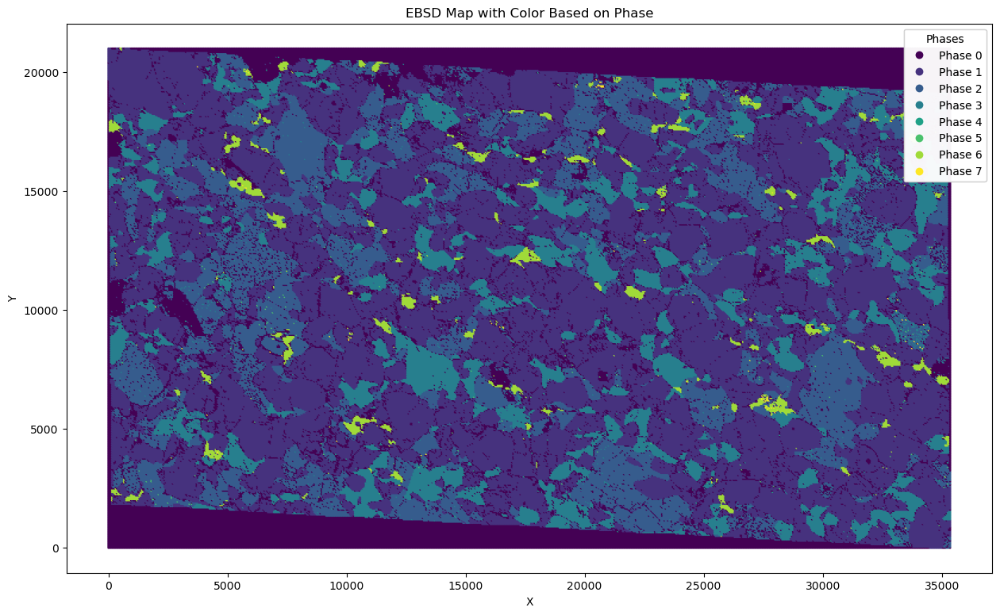

In [10]:
ebsd.plot(cmap = "viridis")

In the above map, we can see the coordinates of x and y and the corresponding pixels with each representing a pixels, we can be able to look which phases each pixels correspond to. Let's save the above plot with a dpi of 300, with legend plotted lower right for seeing upper right clearly

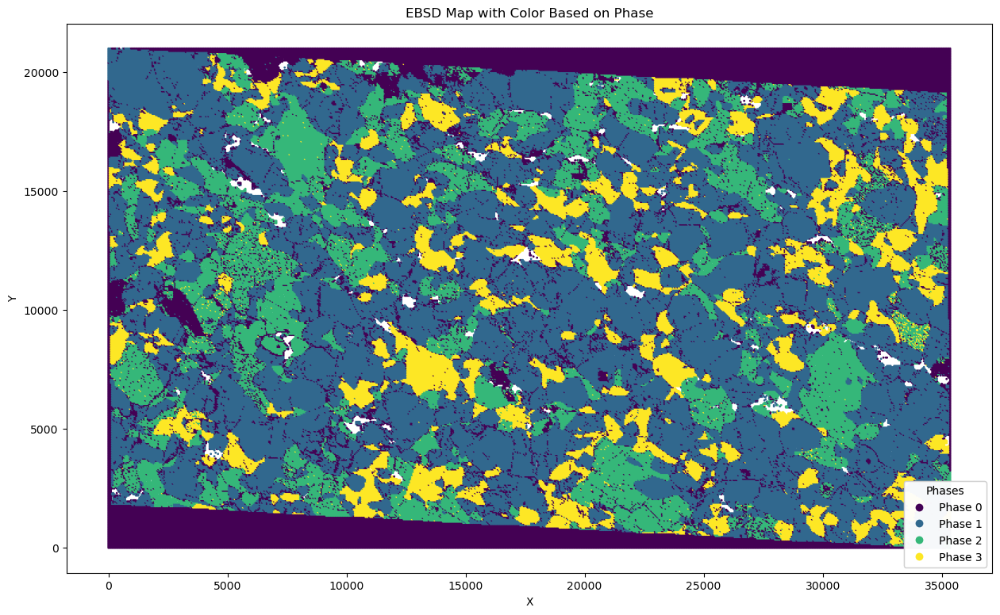

In [11]:
ebsd.plot(df, cmap = "viridis", save_image= True, image_filename= "ebsd.png", legend_location="lower right")

Now, the above plot doesnt account for the crystal symmetry. Let's look at the orientation distribution function and pole density function

Orientation Distribution Function (ODF): Think of the ODF as a way to describe how materials like metals or crystals are arranged in different directions. Imagine you're looking at a pile of stacked books from various angles. The ODF tells you how many books are stacked in each direction, helping understand the overall pattern or texture of the stack.

Pole Density Function: This is like zooming in on a specific part of the pile of books and counting how many books are stacked in a particular orientation. It gives a more detailed view of how the books are aligned in a specific area, which can be useful for studying local patterns or properties.

In simple words ODF and PDF consider crystal symmetries and a fixed sample reference

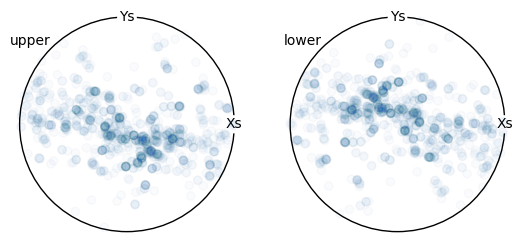

In [12]:
ebsd.odf(df)

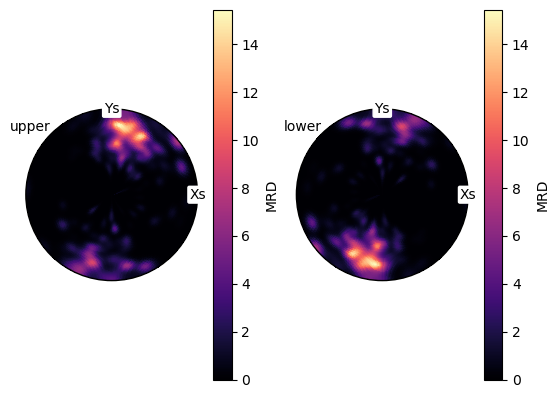

In [13]:
ebsd.pdf(df)

Lets look at inverse pole figure. Inverse pole figure fixes the crystal symmetry and looks at orientation by changing the specimen reference

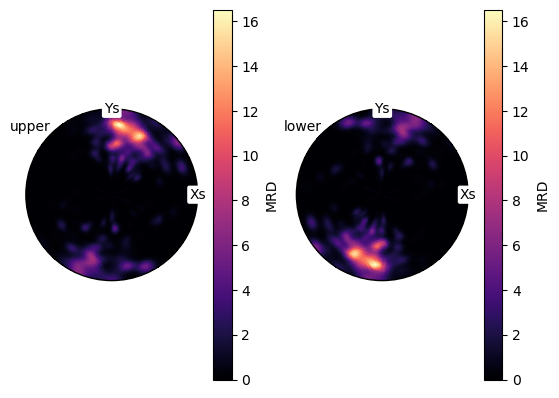

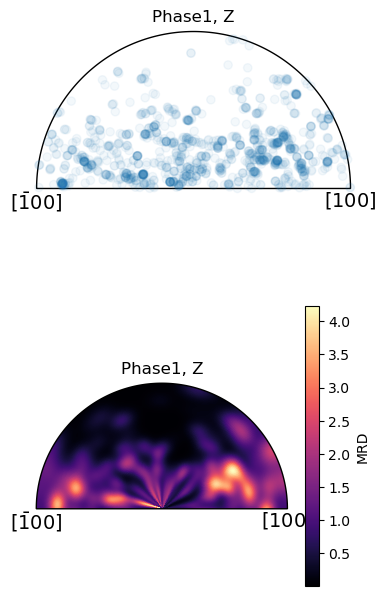

In [14]:
ebsd.ipf(df)

# Plot the ebsd file, default: x2east, zoutofplane

Lets plot the ebsd map relative to the instrument reference system. We can check the map corresponding to the odf and pdf too. 

The default plotting system ```ebsd.plot(df)``` plots x to the east and z axis out of the plane

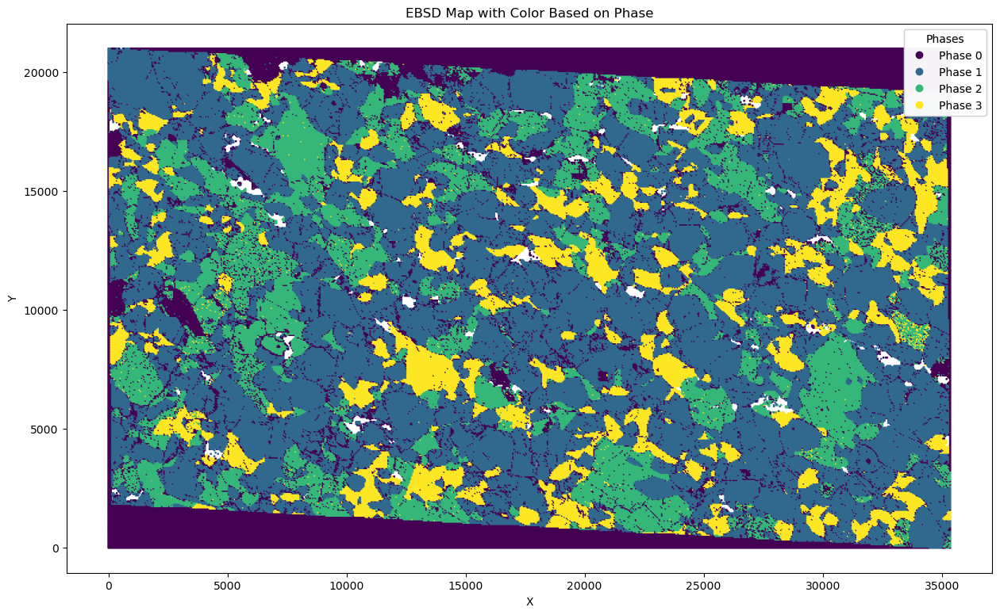

In [15]:
ebsd.plot(df)

In [16]:
## Placeholder for defining densities and stiffness tensors the traditional way


# rho_Fo = 3355
# rho_diop = 3286
# rho_ens = 3306

# cij_Fo = np.array([[320.5, 68.15, 71.6, 0, 0, 0],
#                 [68.15, 196.5, 76.8, 0, 0, 0],
#                 [71.6, 76.8, 233.5, 0, 0, 0],
#                 [0, 0, 0, 64, 0, 0],
#                 [0, 0, 0, 0, 77, 0],
#                 [0, 0, 0, 0, 0, 78.7]])
# cij_ens = np.array([[236.90, 79.60, 63.20, 0.00, 0.00, 0.00],
#                 [79.60, 180.50, 56.80, 0.00, 0.00, 0.00],
#                 [63.20, 56.80, 230.40, 0.00, 0.00, 0.00],
#                 [0.00, 0.00, 0.00, 84.30, 0.00, 0.00],
#                 [0.00, 0.00, 0.00, 0.00, 79.40, 0.00],
#                 [0.00, 0.00, 0.00, 0.00, 0.00, 80.10]])
# cij_diop = np.array([[228.10, 78.80, 70.20, 0.00, 7.90, 0.00],
#                 [78.80, 181.10, 61.10, 0.00, 5.90, 0.00],
#                 [70.20, 61.10, 245.40, 0.00, 39.70, 0.00],
#                 [0.00, 0.00, 0.00, 78.90, 0.00, 6.40],
#                 [7.90, 5.90, 39.70, 0.00, 68.20, 0.00],
#                 [0.00, 0.00, 0.00, 6.40, 0.00, 78.10]])
# cij = [cij_Fo, cij_ens, cij_diop]
# density = [rho_Fo, rho_ens, rho_diop]

# Calculate the stiffness tensors and the density at Pressure = 2GPa and Temperature = 1500 K

Now, lets import the material stiffness tensors and density at different pressure and temperature. We do this by creating a material instance of the Material class, and then calling the ```load_density``` function and ```voigthighPT``` function of the Material class in the following way. The resultant is stored in a variable, which in this case is rho_Fo and cij_Fo, and consequently we create an array to keep these matrix and density in a different variable, here it is called cij, density. The voigt stiffness matrix and the density of material is called at pressure = 2GPa and Temperature = 1500K

In [17]:
material_instance = Material()
rho_Fo = material_instance.load_density("Forsterite", 2, 1500)
rho_diop = material_instance.load_density("Diopside", 2, 1500)
rho_ens = material_instance.load_density("Enstatite", 2, 1500)
cij_Fo = material_instance.voigthighPT('Forsterite', PRESSURE = 2, TEMP = 1500)
cij_ens = material_instance.voigthighPT('Enstatite', PRESSURE = 2, TEMP = 1500)
cij_diop = material_instance.voigthighPT('Diopside', PRESSURE = 2, TEMP = 1500)

In [18]:
cij = [cij_Fo, cij_ens, cij_diop]
density = [rho_Fo, rho_ens, rho_diop]

# Get the euler angles from ebsd file

Now, we also obtain the euler angles corresponding to the phases whose matrix and density information we extracted above, and then store them in an array format in the variable called euler_angles

In [19]:
forsterite = ebsd.get_euler_angles(phase = 1, data=df)
enstatite = ebsd.get_euler_angles(phase = 2, data=df)
diopside = ebsd.get_euler_angles(phase = 3, data=df)
euler_angles = [forsterite, enstatite, diopside]

Lets calculate anisotropy from the ebsd file. we first calculate the average tensor and average density by giving the directive ```average_tensor, average_density = ebsd.getAnisotropyForEBSD(cij, euler_angles, density)```, and then calculate anisotropy after creating an instance of the Anisotropy class, which can be called using ```anis = Anisotropy(average_tensor*10**9, average_density)```. Afterwards we plot the anisotropy using the directive ```anis.plot()```


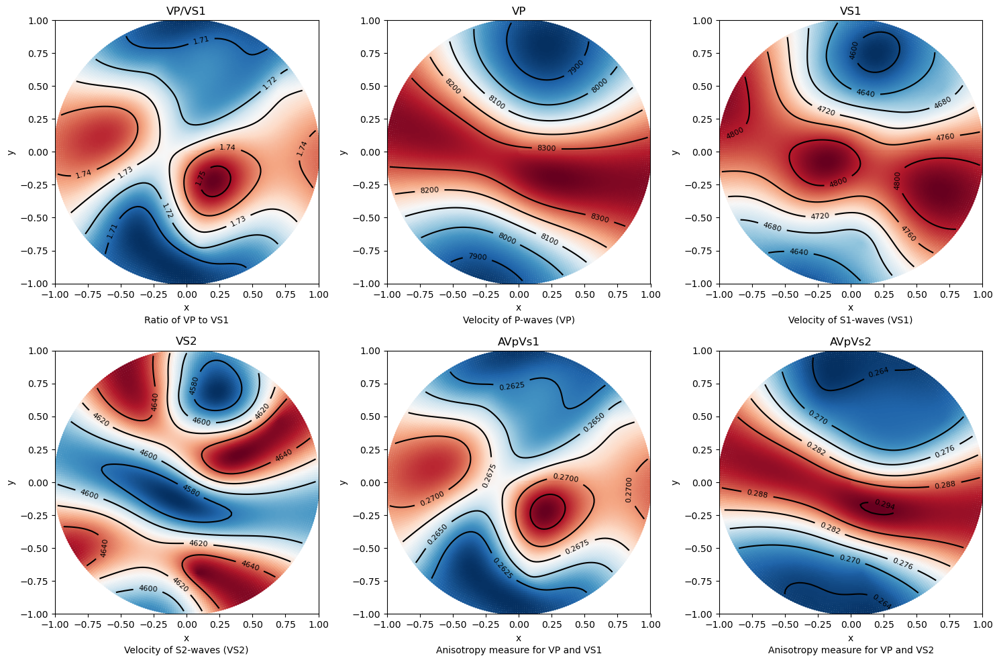

In [20]:
average_tensor, average_density = ebsd.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

Now, lets calculate some values related to anisotropy measures

In [21]:
anis.anisotropy_values()

Max Vp:  8396.209000295552
Min Vp:  7854.540578439971
Max Vs1:  4825.962708188066
Min Vs1:  4587.879158847023
Max Vs2:  4659.07253714201
Min Vs2:  4567.2278529689
Max vs anisotropy percent:  5.49110239470277
Min vs anisotropy percent:  0.020949132527876543
P wave anisotropy percent:  6.666380762698684
S1 Wave anisotropy percent:  5.058159096016941
S2 Wave anisotropy percent:  1.9909320158609338
Velocity difference:  257.9143651648319
Vp/Vs1 ratio:  2.8229007664160775


{'maxvp': 8396.209000295552,
 'minvp': 7854.540578439971,
 'maxvs1': 4825.962708188066,
 'minvs1': 4587.879158847023,
 'maxvs2': 4659.07253714201,
 'minvs2': 4567.2278529689,
 'max_vs_anisotropy_percent': 5.49110239470277,
 'min_vs_anisotropy_percent': 0.020949132527876543,
 'p_wave_anisotropy_percent': 6.666380762698684,
 's1_wave_anisotropy_percent': 5.058159096016941,
 's2_wave_anisotropy_percent': 1.9909320158609338,
 'maxdvs': 257.9143651648319,
 'AVpVs1': 2.8229007664160775}

Lets look at the average tensors of all the phases

In [22]:
cij

[array([[297.72,  64.96,  71.44,   0.  ,   0.  ,   0.  ],
        [ 64.96, 175.9 ,  79.5 ,   0.  ,   0.  ,   0.  ],
        [ 71.44,  79.5 , 211.92,   0.  ,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,  52.88,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,  64.72,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,   0.  ,  65.32]]),
 array([[216.74,  68.1 ,  43.22,   0.  ,   0.  ,   0.  ],
        [ 68.1 , 159.52,  61.42,   0.  ,   0.  ,   0.  ],
        [ 43.22,  61.42, 201.32,   0.  ,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,  73.34,   0.  ,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,  68.68,   0.  ],
        [  0.  ,   0.  ,   0.  ,   0.  ,   0.  ,  68.2 ]]),
 array([[219.06,  78.88,  76.02,   0.  ,   8.98,   0.  ],
        [ 78.88, 170.12,  56.14,   0.  ,  10.28,   0.  ],
        [ 76.02,  56.14, 212.58,   0.  ,  53.62,   0.  ],
        [  0.  ,   0.  ,   0.  ,  69.58,   0.  ,  13.1 ],
        [  8.98,  10.28,  53.62,   0.  ,  64.36,   0.  ],
        [ 

# Rotating the dataset by 90 degree around the z-axis

Lets rotate the ebsd by 90 degree around the z-axis, and not keeping x and y fixed by evoking the ```rotateEBSD``` nmethod. That means that the X and Y will change after we make the rotation. There are 3 angles through which we can make rotations. The following directive stores the rotated ebsd file in another dataframe called ```rotated``` here

In [23]:
rotated = ebsd.rotateEBSD(df, [180, 0, 90], keepXY = False)

  0%|                                      | 8/293057 [00:00<1:59:23, 40.91it/s]/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/santex/ebsd/rotateEBSD.py:35: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/santex/ebsd/rotateEBSD.py:35: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/santex/ebsd/rotateEBSD.py:35: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/l

Lets look at the resultant dataframe ```rotated``` and compare it with the previous dataframe ```df```

In previous datafame, X and Y started from 0, 0 and then X and Y incremented.

This is a sample of previous unrotated dataframe

```
	Phase	X	Y	Bands	Error	Euler1	Euler2	Euler3	MAD	BC	BS
0	0	0.0	0.0	0	5	360.0	180.0	0.0	0.0	0	0
1	0	50.0	0.0	0	5	360.0	180.0	0.0	0.0	0	0
2	0	100.0	0.0	0	5	360.0	180.0	0.0	0.0	0	0
3	0	150.0	0.0	0	5	360.0	180.0	0.0	0.0	0	0
4	0	200.0	0.0	0	5	360.0	180.0	0.0	0.0	0	0```

In [24]:
rotated

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,0,0.000000e+00,0.0,0,5,270.0,180.0,0.0,0.0,0,0
1,0,-1.110223e-14,-50.0,0,5,270.0,180.0,0.0,0.0,0,0
2,0,-2.220446e-14,-100.0,0,5,270.0,180.0,0.0,0.0,0,0
3,0,-3.330669e-14,-150.0,0,5,270.0,180.0,0.0,0.0,0,0
4,0,-4.440892e-14,-200.0,0,5,270.0,180.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
298063,0,2.100000e+04,-35150.0,0,5,270.0,180.0,0.0,0.0,0,0
298064,0,2.100000e+04,-35200.0,0,5,270.0,180.0,0.0,0.0,0,0
298065,0,2.100000e+04,-35250.0,0,5,270.0,180.0,0.0,0.0,0,0
298066,0,2.100000e+04,-35300.0,0,5,270.0,180.0,0.0,0.0,0,0


Lets look at the rotated dataframe visually. Now here in the bottom plot we can see that with the same plot command, the x and y values now correspond to different pixels

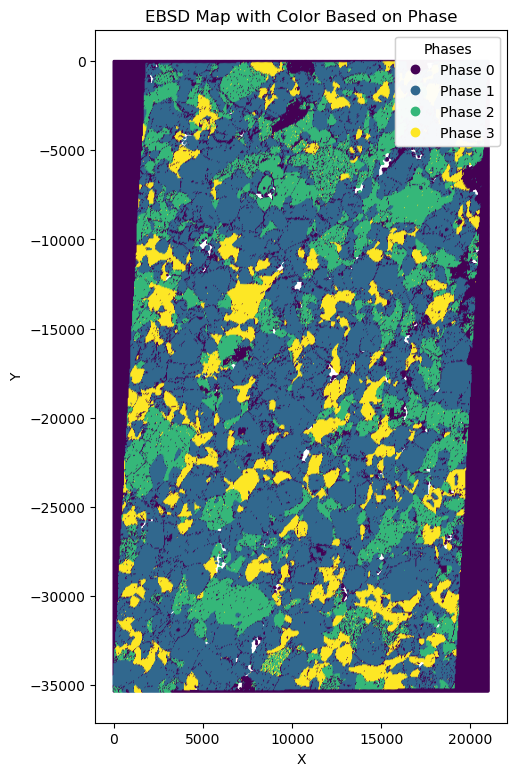

In [25]:
ebsd.plot(rotated)

Let's now again calculate and plot the anisotropy maps using the procedure explained before

In [26]:
forsterite = ebsd.get_euler_angles(phase = 1, data=rotated)
enstatite = ebsd.get_euler_angles(phase = 2, data=rotated)
diopside = ebsd.get_euler_angles(phase = 3, data=rotated)
euler_angles = [forsterite, enstatite, diopside]

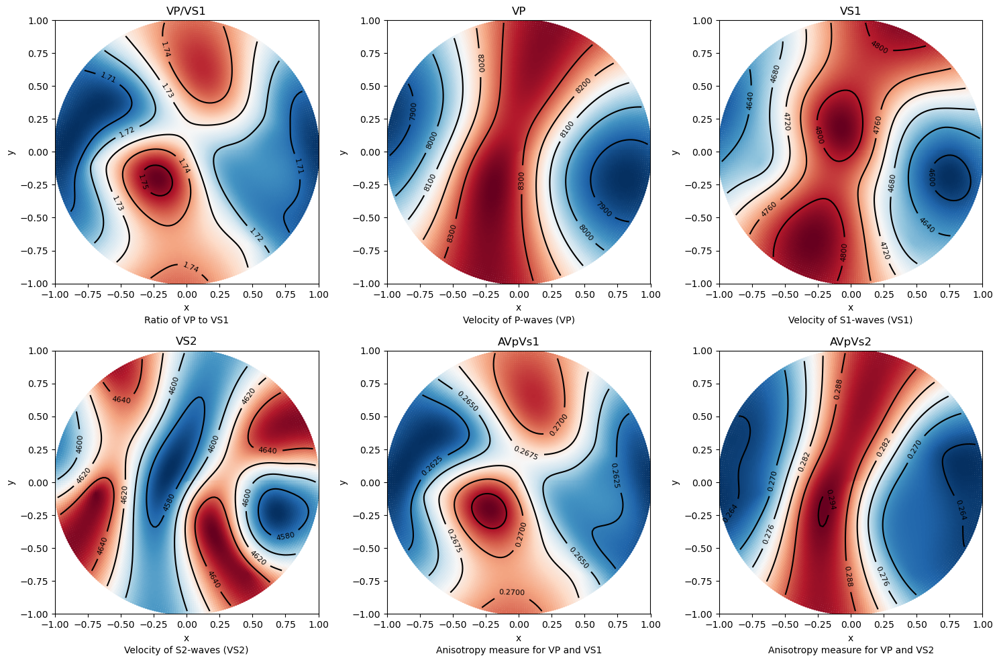

In [27]:
average_tensor, average_density = ebsd.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

In [28]:
anis.anisotropy_values()

Max Vp:  8396.209000295552
Min Vp:  7854.54057843997
Max Vs1:  4825.962708188066
Min Vs1:  4587.879158847021
Max Vs2:  4659.072537142012
Min Vs2:  4567.227852968899
Max vs anisotropy percent:  5.49110239470281
Min vs anisotropy percent:  0.02094913252785702
P wave anisotropy percent:  6.666380762698695
S1 Wave anisotropy percent:  5.05815909601698
S2 Wave anisotropy percent:  1.9909320158609929
Velocity difference:  257.9143651648337
Vp/Vs1 ratio:  2.8229007664161405


{'maxvp': 8396.209000295552,
 'minvp': 7854.54057843997,
 'maxvs1': 4825.962708188066,
 'minvs1': 4587.879158847021,
 'maxvs2': 4659.072537142012,
 'minvs2': 4567.227852968899,
 'max_vs_anisotropy_percent': 5.49110239470281,
 'min_vs_anisotropy_percent': 0.02094913252785702,
 'p_wave_anisotropy_percent': 6.666380762698695,
 's1_wave_anisotropy_percent': 5.05815909601698,
 's2_wave_anisotropy_percent': 1.9909320158609929,
 'maxdvs': 257.9143651648337,
 'AVpVs1': 2.8229007664161405}

# Rotating ebsd for matching SEM orientation

In [29]:
ebsd = EBSD("ebsd.ctf")
df = ebsd.get_ebsd_data()
df = ebsd.filterByPhaseNumberList(df = df, phase_list = [4, 5, 6, 7])

Let's now rotate ebsd which plots x to south and z into plane, without keeping keeping x and y same

In [30]:
rotated_df = ebsd.plot_rotate_ebsd(sample_ref = ["x2west", "zIntoPlane"], ebsd_df = df, keepXY = False)

  0%|                                                | 0/293057 [00:00<?, ?it/s]/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/santex/ebsd/rotateEBSD.py:35: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/santex/ebsd/rotateEBSD.py:35: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/lib/python3.12/site-packages/santex/ebsd/rotateEBSD.py:35: UserWarning: Gimbal lock detected. Setting third angle to zero since it is not possible to uniquely determine all angles.
  phi1_res, Phi_res, phi2_res = resultant_rot.as_euler('zxz', degrees=True)
/Users/usin8611/anaconda3/envs/pygmt/l

Lets check how the rotated dataframe looks like. We have rotated the dataframe without keeping X and Y intact, essentially we have changed the plotting conventions

In [31]:
rotated_df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,0,0.0,0.000000e+00,0,5,180.0,0.0,0.0,0.0,0,0
1,0,-50.0,6.123234e-15,0,5,180.0,0.0,0.0,0.0,0,0
2,0,-100.0,1.224647e-14,0,5,180.0,0.0,0.0,0.0,0,0
3,0,-150.0,1.836970e-14,0,5,180.0,0.0,0.0,0.0,0,0
4,0,-200.0,2.449294e-14,0,5,180.0,0.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
298063,0,-35150.0,2.100000e+04,0,5,180.0,0.0,0.0,0.0,0,0
298064,0,-35200.0,2.100000e+04,0,5,180.0,0.0,0.0,0.0,0,0
298065,0,-35250.0,2.100000e+04,0,5,180.0,0.0,0.0,0.0,0,0
298066,0,-35300.0,2.100000e+04,0,5,180.0,0.0,0.0,0.0,0,0


Lets plot the new ebsd map with different plotting conventions

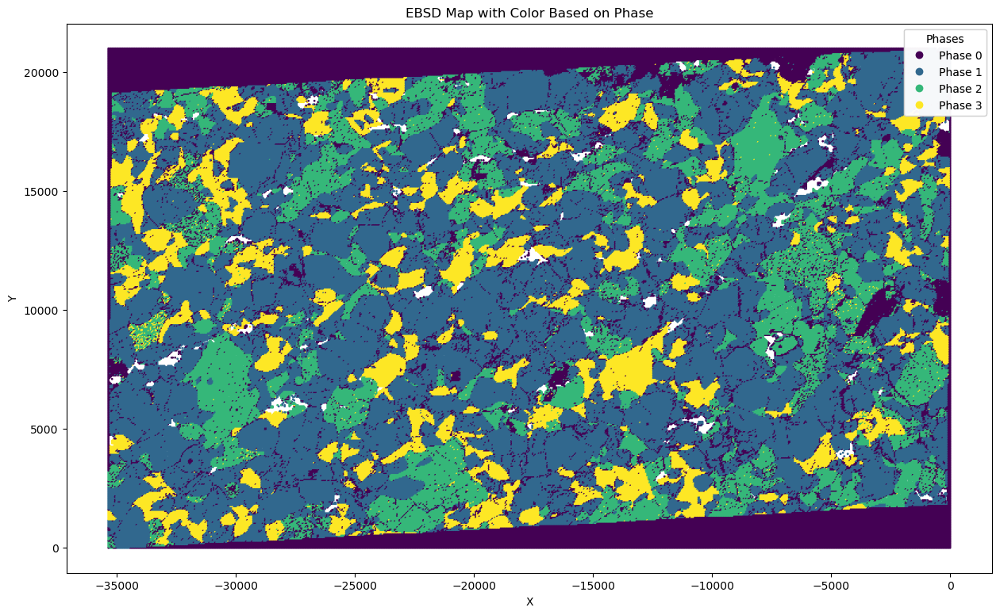

In [32]:
ebsd.plot(rotated_df)

Lets check the anisotropy now, and compare it with previous one

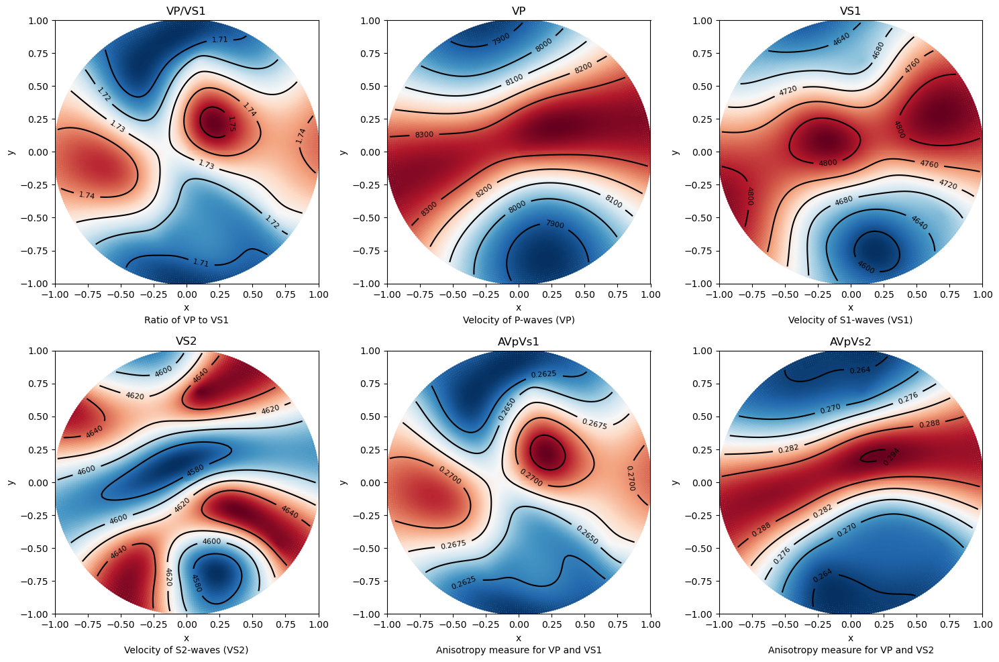

In [33]:
forsterite = ebsd.get_euler_angles(phase = 1, data=rotated_df)
enstatite = ebsd.get_euler_angles(phase = 2, data=rotated_df)
diopside = ebsd.get_euler_angles(phase = 3, data=rotated_df)
euler_angles = [forsterite, enstatite, diopside]

average_tensor, average_density = ebsd.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

In [34]:
anis.anisotropy_values()

Max Vp:  8396.209000295552
Min Vp:  7854.540578439972
Max Vs1:  4825.962708188067
Min Vs1:  4587.879158847024
Max Vs2:  4659.072537142009
Min Vs2:  4567.2278529689
Max vs anisotropy percent:  5.491102394702732
Min vs anisotropy percent:  0.020949132527817983
P wave anisotropy percent:  6.6663807626986715
S1 Wave anisotropy percent:  5.05815909601694
S2 Wave anisotropy percent:  1.9909320158609145
Velocity difference:  257.9143651648301
Vp/Vs1 ratio:  2.8229007664161148


{'maxvp': 8396.209000295552,
 'minvp': 7854.540578439972,
 'maxvs1': 4825.962708188067,
 'minvs1': 4587.879158847024,
 'maxvs2': 4659.072537142009,
 'minvs2': 4567.2278529689,
 'max_vs_anisotropy_percent': 5.491102394702732,
 'min_vs_anisotropy_percent': 0.020949132527817983,
 'p_wave_anisotropy_percent': 6.6663807626986715,
 's1_wave_anisotropy_percent': 5.05815909601694,
 's2_wave_anisotropy_percent': 1.9909320158609145,
 'maxdvs': 257.9143651648301,
 'AVpVs1': 2.8229007664161148}

Lets now rotate the ebsd file with some rotation angles

In [35]:
ebsd = EBSD("ebsd.ctf")
df = ebsd.get_ebsd_data()
df = ebsd.filterByPhaseNumberList(df = df, phase_list = [4, 5, 6, 7])

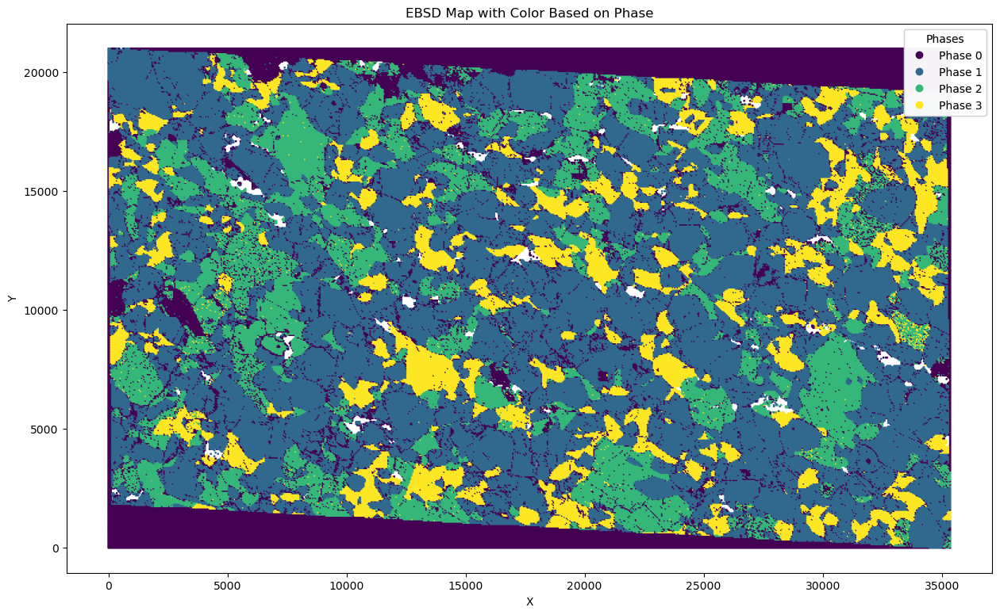

In [36]:
ebsd.plot(data = df, rotation_angle=0)

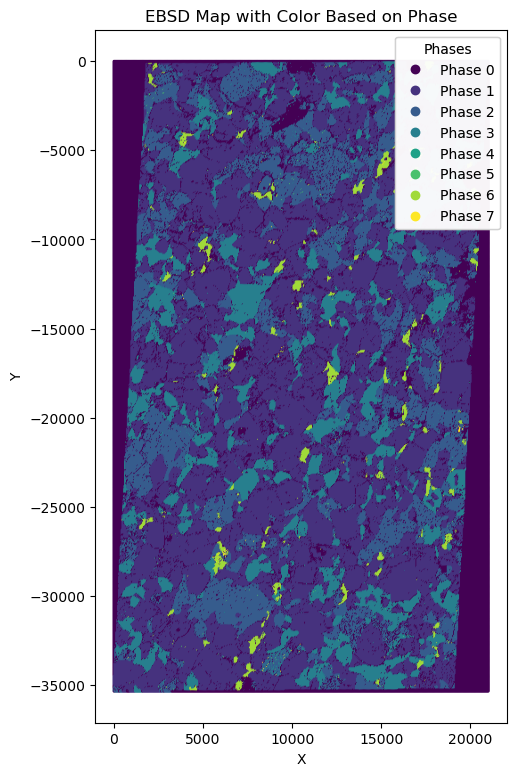

In [37]:
ebsd.plot(rotation_angle=90)

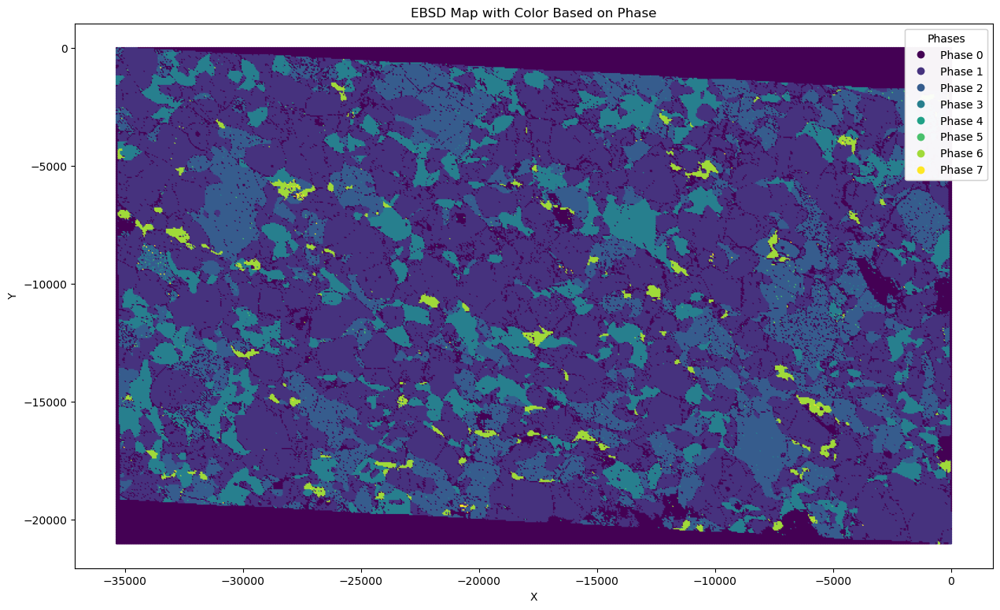

In [39]:
ebsd.plot(rotation_angle=180)

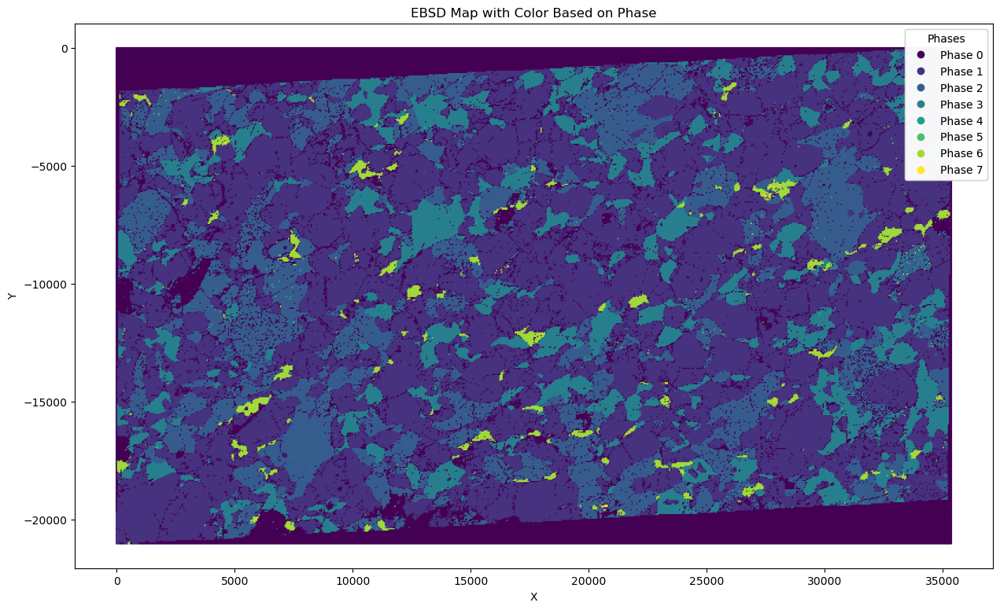

In [40]:
ebsd.plot(rotation_angle=180, mirror=True)

In [41]:
ebsdfile = EBSD("ebsd.ctf")

df = ebsdfile.get_ebsd_data()

In [42]:
rotated = ebsdfile.rotateEBSD(df, [70, 160, 50], keepXY = False)

100%|████████████████████████████████| 298068/298068 [00:18<00:00, 15966.09it/s]


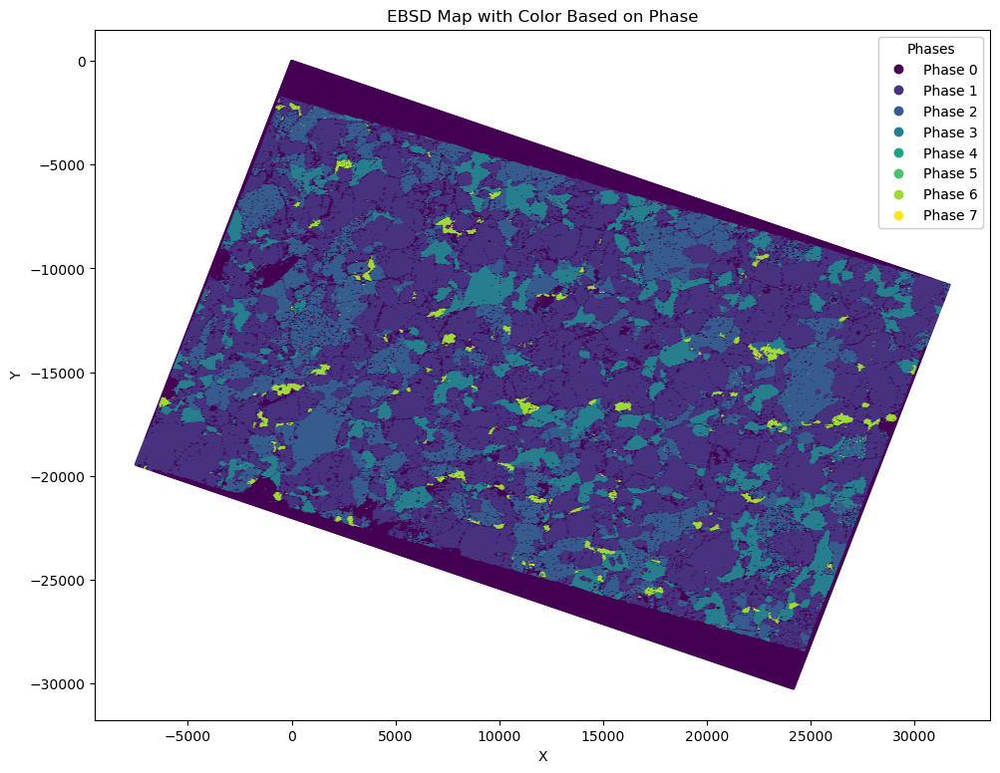

In [43]:
ebsdfile.plot(rotated)

Now, for the above rotation of EBSD data for custom angles, we can calculate anisotropy in the same way described above

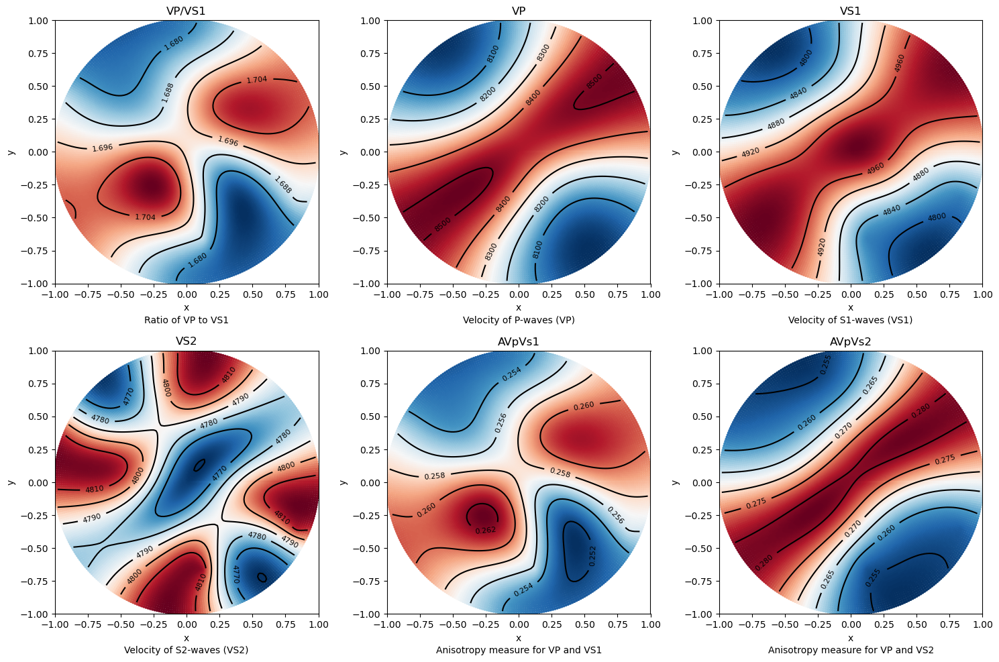

In [44]:
rotated_df = rotated

rho_Fo = 3355
rho_diop = 3286
rho_ens = 3306

cij_Fo = np.array([[320.5, 68.15, 71.6, 0, 0, 0],
                [68.15, 196.5, 76.8, 0, 0, 0],
                [71.6, 76.8, 233.5, 0, 0, 0],
                [0, 0, 0, 64, 0, 0],
                [0, 0, 0, 0, 77, 0],
                [0, 0, 0, 0, 0, 78.7]])
cij_ens = np.array([[236.90, 79.60, 63.20, 0.00, 0.00, 0.00],
                [79.60, 180.50, 56.80, 0.00, 0.00, 0.00],
                [63.20, 56.80, 230.40, 0.00, 0.00, 0.00],
                [0.00, 0.00, 0.00, 84.30, 0.00, 0.00],
                [0.00, 0.00, 0.00, 0.00, 79.40, 0.00],
                [0.00, 0.00, 0.00, 0.00, 0.00, 80.10]])
cij_diop = np.array([[228.10, 78.80, 70.20, 0.00, 7.90, 0.00],
                [78.80, 181.10, 61.10, 0.00, 5.90, 0.00],
                [70.20, 61.10, 245.40, 0.00, 39.70, 0.00],
                [0.00, 0.00, 0.00, 78.90, 0.00, 6.40],
                [7.90, 5.90, 39.70, 0.00, 68.20, 0.00],
                [0.00, 0.00, 0.00, 6.40, 0.00, 78.10]])
cij = [cij_Fo, cij_ens, cij_diop]
density = [rho_Fo, rho_ens, rho_diop]

forsterite = ebsdfile.get_euler_angles(phase = 1, data=rotated_df)
enstatite = ebsdfile.get_euler_angles(phase = 2, data=rotated_df)
diopside = ebsdfile.get_euler_angles(phase = 3, data=rotated_df)
euler_angles = [forsterite, enstatite, diopside]

average_tensor, average_density = ebsdfile.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

# Cleaning EBSD data

The steps of cleaning EBSD data includes removing unwanted phases and removing pixels whose mean angular deviation is more than some specified threshold, lets say 0.7 and to remove grains with mean misorientation more than some specified threshold, lets say 10 degrees. In the above steps, we aim to clean EBSD data on these principles.

In [45]:
ebsdfile = EBSD("ebsd.ctf")

In [46]:
phases_available = ebsdfile.phases()
print(phases_available)


[(0, 'NaN', 19.37141860246655), (1, 'Forsterite', 48.060509682354365), (2, 'Enstatite  Opx AV77', 18.747735416079554), (3, 'Diopside   CaMgSi2O6', 12.139176295342002), (4, 'Anorthite', 0.054014520176604), (5, 'Hornblende', 0.0781700819947126), (6, 'Chromite', 1.5160969980004564), (7, 'Pyrope', 0.032878403585758956)]


In [47]:
df = ebsdfile.get_ebsd_data()

In [48]:
df

,Phase,X,Y,Bands,Error,Euler1,Euler2,Euler3,MAD,BC,BS
0,0,0.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
1,0,50.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
2,0,100.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
3,0,150.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
4,0,200.0,0.0,0,5,360.0,180.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
298063,0,35150.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298064,0,35200.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298065,0,35250.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0
298066,0,35300.0,21000.0,0,5,360.0,180.0,0.0,0.0,0,0


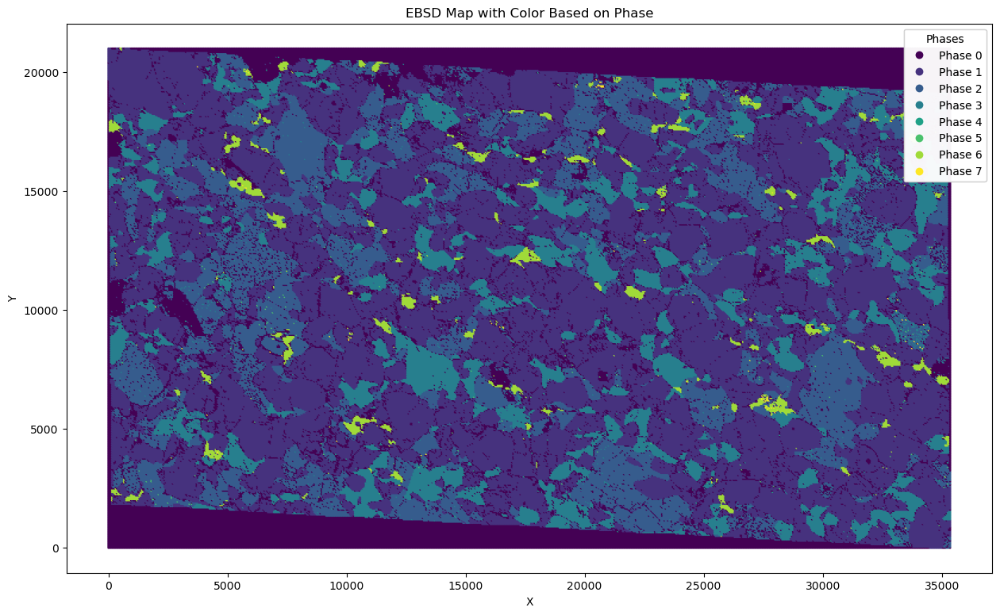

In [49]:
ebsdfile.plot(df)

# Removing data with MAD > 0.7

We now aim to remove pixels with mean angular deviation greater than 0.7, which can be done by invoking the ```filterMAD()``` method of the ebsd object

In [50]:
filtered_df = ebsd.filterMAD(df, 0.7)
print(filtered_df)

        Phase        X        Y  Bands  Error  Euler1  Euler2  Euler3  MAD  \
0           0      0.0      0.0      0      5   360.0   180.0     0.0  0.0   
1           0     50.0      0.0      0      5   360.0   180.0     0.0  0.0   
2           0    100.0      0.0      0      5   360.0   180.0     0.0  0.0   
3           0    150.0      0.0      0      5   360.0   180.0     0.0  0.0   
4           0    200.0      0.0      0      5   360.0   180.0     0.0  0.0   
...       ...      ...      ...    ...    ...     ...     ...     ...  ...   
298063      0  35150.0  21000.0      0      5   360.0   180.0     0.0  0.0   
298064      0  35200.0  21000.0      0      5   360.0   180.0     0.0  0.0   
298065      0  35250.0  21000.0      0      5   360.0   180.0     0.0  0.0   
298066      0  35300.0  21000.0      0      5   360.0   180.0     0.0  0.0   
298067      0  35350.0  21000.0      0      5   360.0   180.0     0.0  0.0   

        BC  BS  
0        0   0  
1        0   0  
2        0  

Here we again check the ebsd plot after removing pixels with MAD>0.7

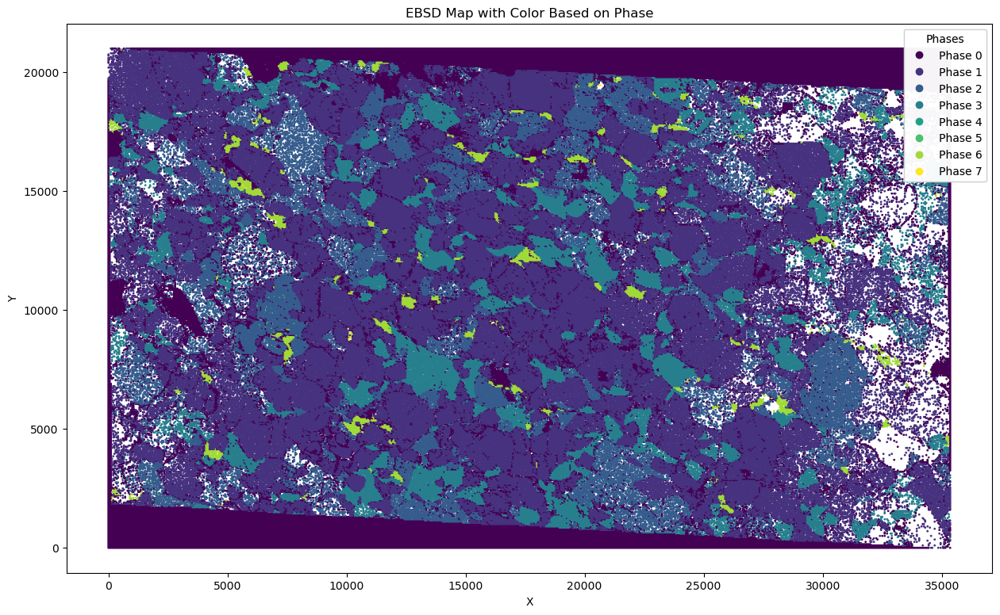

In [51]:
ebsdfile.plot(filtered_df)

# Calculating grain boundaries with threshold of 10 degrees misorientation

Let's now calculate grain boundaries with misorientation of 10 degrees. we calculate that by invoking the calcGrains() method. Here, we can modify the angles to classify the grains by modifying the parameter ```threshold```

Grain 0: Dominant Phase - Forsterite, Size - 821
Grain 1: Dominant Phase - Enstatite  Opx AV77, Size - 1338
Grain 2: Dominant Phase - Enstatite  Opx AV77, Size - 17
Grain 3: Dominant Phase - Forsterite, Size - 263
Grain 4: Dominant Phase - Forsterite, Size - 3725
Grain 5: Dominant Phase - Diopside   CaMgSi2O6, Size - 2278
Grain 6: Dominant Phase - Forsterite, Size - 686
Grain 7: Dominant Phase - Forsterite, Size - 5184
Grain 8: Dominant Phase - Forsterite, Size - 561
Grain 9: Dominant Phase - Diopside   CaMgSi2O6, Size - 6
Grain 10: Dominant Phase - Forsterite, Size - 344
Grain 11: Dominant Phase - Enstatite  Opx AV77, Size - 486
Grain 12: Dominant Phase - Diopside   CaMgSi2O6, Size - 257
Grain 13: Dominant Phase - Forsterite, Size - 1033
Grain 14: Dominant Phase - Forsterite, Size - 255
Grain 15: Dominant Phase - Forsterite, Size - 5930
Grain 16: Dominant Phase - Chromite, Size - 1
Grain 17: Dominant Phase - Diopside   CaMgSi2O6, Size - 178
Grain 18: Dominant Phase - Forsterite, Size 

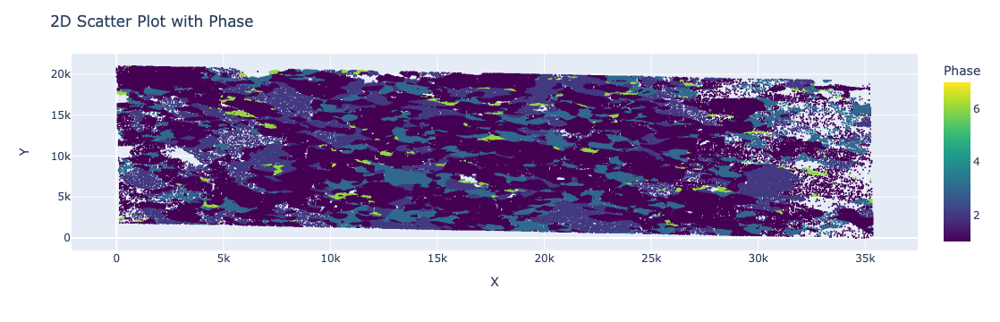

In [52]:
phases_names = ebsdfile.phases_names()
phases_names = phases_names['phase'].tolist()
phases_names.insert(0, "na")

df_grain_boundary = ebsdfile.calcGrains(df = filtered_df, threshold = 10, phase_names=phases_names, downsampling_factor=1)

# Removing grains with grain size less than 10 pixels

Now, once the grains are calculated above, the next step is to remove grains whose size is less than 10 pixels

Grain 0: Dominant Phase - Forsterite, Size - 821
Grain 1: Dominant Phase - Enstatite  Opx AV77, Size - 1338
Grain 2: Dominant Phase - Enstatite  Opx AV77, Size - 17
Grain 3: Dominant Phase - Forsterite, Size - 263
Grain 4: Dominant Phase - Forsterite, Size - 3725
Grain 5: Dominant Phase - Diopside   CaMgSi2O6, Size - 2278
Grain 6: Dominant Phase - Forsterite, Size - 686
Grain 7: Dominant Phase - Forsterite, Size - 5184
Grain 8: Dominant Phase - Forsterite, Size - 561
Grain 10: Dominant Phase - Forsterite, Size - 344
Grain 11: Dominant Phase - Enstatite  Opx AV77, Size - 486
Grain 12: Dominant Phase - Diopside   CaMgSi2O6, Size - 257
Grain 13: Dominant Phase - Forsterite, Size - 1033
Grain 14: Dominant Phase - Forsterite, Size - 255
Grain 15: Dominant Phase - Forsterite, Size - 5930
Grain 17: Dominant Phase - Diopside   CaMgSi2O6, Size - 178
Grain 18: Dominant Phase - Forsterite, Size - 111
Grain 19: Dominant Phase - Enstatite  Opx AV77, Size - 899
Grain 20: Dominant Phase - Diopside   

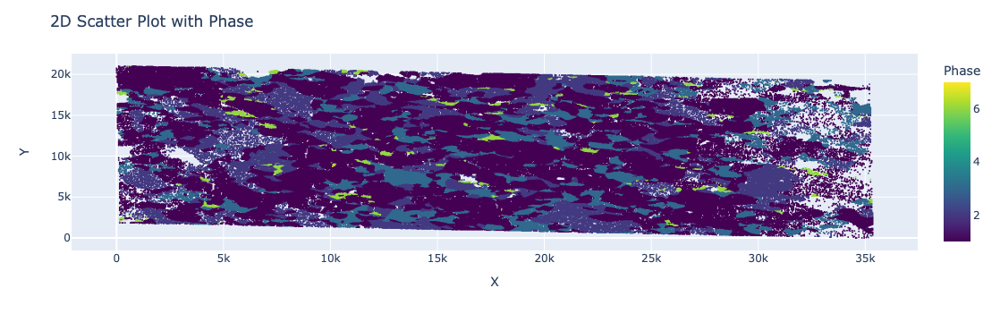

In [53]:
filtered_df_grain_boundary = ebsdfile.filterByGrainSize(df_grain_boundary, phases_names, min_grain_size=10)

Now, lets check the number of pixels which were originally present in the EBSD data

In [54]:
len(df)

298068

The number of pixels originally in the ebsd data was 298068, now, lets check the length of the ebsd data after filtering with MAD>0.7

In [55]:
len(filtered_df)

235679

The number of pixels with MAD less than 0.7 is 235679. Now, lets check the length of pixels whose grains misorientation angle is less than 10 degrees

In [57]:
len(filtered_df_grain_boundary)

176984

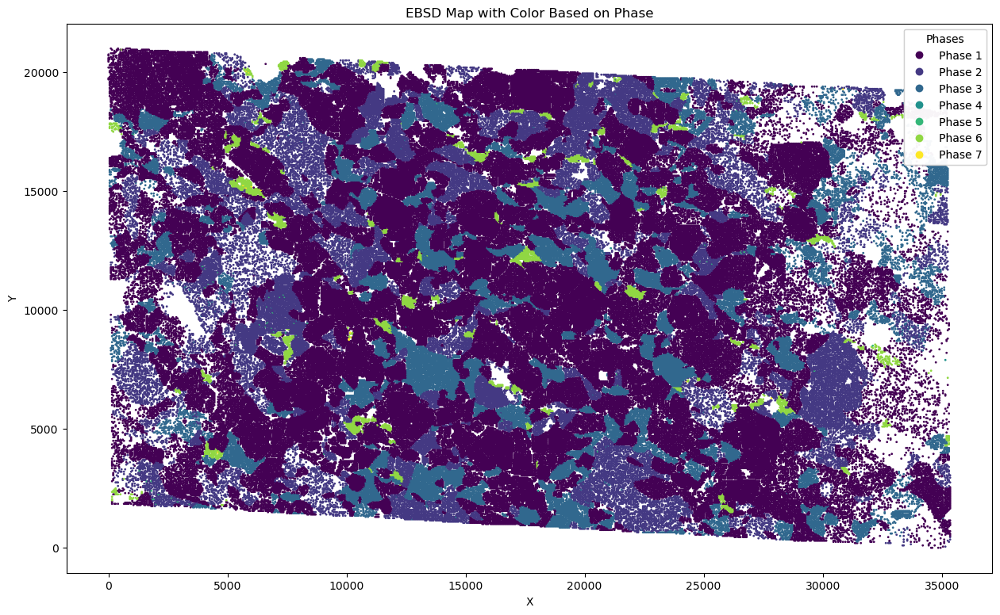

In [58]:
ebsdfile.plot(filtered_df_grain_boundary)

# Calculating Anisotropy

Now, after cleaning the data for MAD and grain size, we now calculate the seismic anisotropy of the above data

In [59]:
material_instance = Material()
rho_Fo = material_instance.load_density("Forsterite", 2, 1500)
rho_diop = material_instance.load_density("Diopside", 2, 1500)
rho_ens = material_instance.load_density("Enstatite", 2, 1500)
cij_Fo = material_instance.voigthighPT('Forsterite', PRESSURE = 2, TEMP = 1500)
cij_ens = material_instance.voigthighPT('Enstatite', PRESSURE = 2, TEMP = 1500)
cij_diop = material_instance.voigthighPT('Diopside', PRESSURE = 2, TEMP = 1500)

In [60]:
cij = [cij_Fo, cij_ens, cij_diop]
density = [rho_Fo, rho_ens, rho_diop]

In [61]:
forsterite = ebsdfile.get_euler_angles(phase = 1, data=filtered_df_grain_boundary)
enstatite = ebsdfile.get_euler_angles(phase = 2, data=filtered_df_grain_boundary)
diopside = ebsdfile.get_euler_angles(phase = 3, data=filtered_df_grain_boundary)
euler_angles = [forsterite, enstatite, diopside]

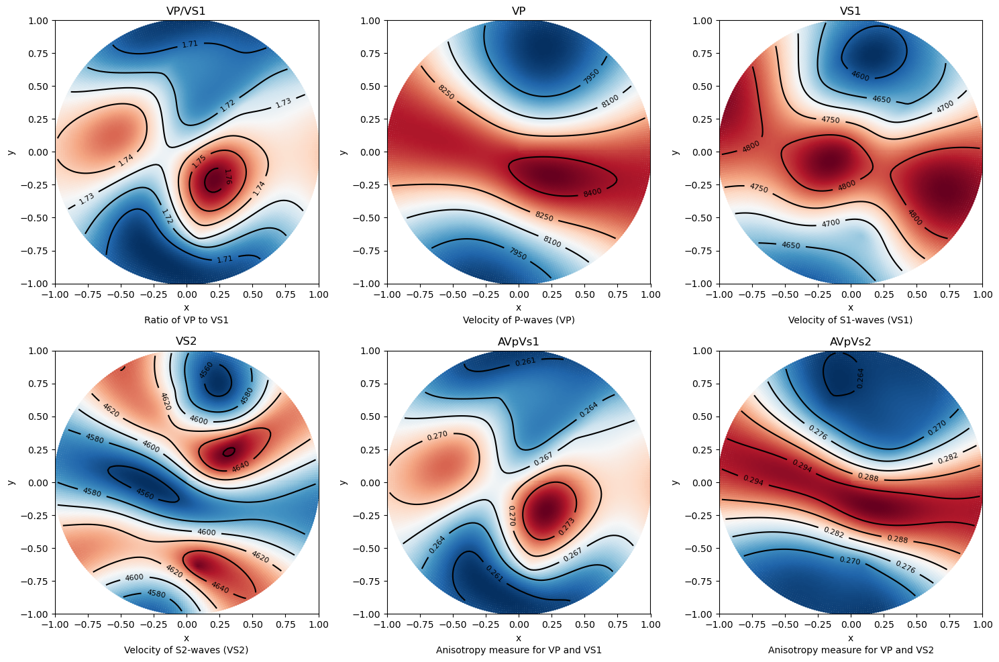

In [62]:
average_tensor, average_density = ebsdfile.getAnisotropyForEBSD(cij, euler_angles, density)
anis = Anisotropy(average_tensor*10**9, average_density)
anis.plot()

In [63]:
anis.anisotropy_values()

Max Vp:  8449.545069720665
Min Vp:  7834.1684457727015
Max Vs1:  4843.772824149944
Min Vs1:  4577.275239228743
Max Vs2:  4661.180158160457
Min Vs2:  4555.315881762446
Max vs anisotropy percent:  6.110766862825683
Min vs anisotropy percent:  0.020842429078130564
P wave anisotropy percent:  7.558185340984474
S1 Wave anisotropy percent:  5.657493372889703
S2 Wave anisotropy percent:  2.297278183366879
Velocity difference:  287.209223367252
Vp/Vs1 ratio:  3.4012758430117644


{'maxvp': 8449.545069720665,
 'minvp': 7834.1684457727015,
 'maxvs1': 4843.772824149944,
 'minvs1': 4577.275239228743,
 'maxvs2': 4661.180158160457,
 'minvs2': 4555.315881762446,
 'max_vs_anisotropy_percent': 6.110766862825683,
 'min_vs_anisotropy_percent': 0.020842429078130564,
 'p_wave_anisotropy_percent': 7.558185340984474,
 's1_wave_anisotropy_percent': 5.657493372889703,
 's2_wave_anisotropy_percent': 2.297278183366879,
 'maxdvs': 287.209223367252,
 'AVpVs1': 3.4012758430117644}

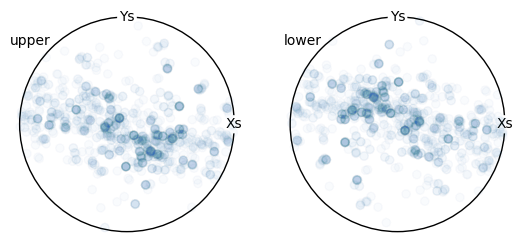

In [64]:
ebsdfile.odf(df)

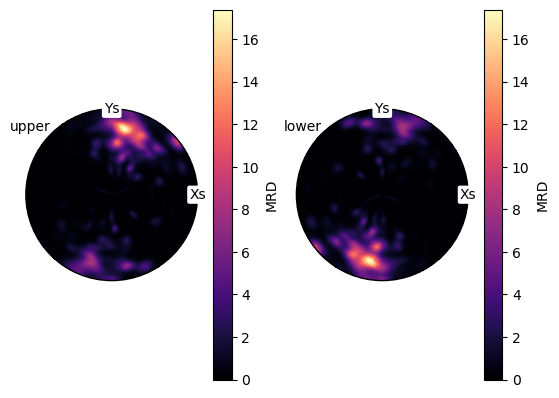

In [65]:
ebsdfile.pdf(df)

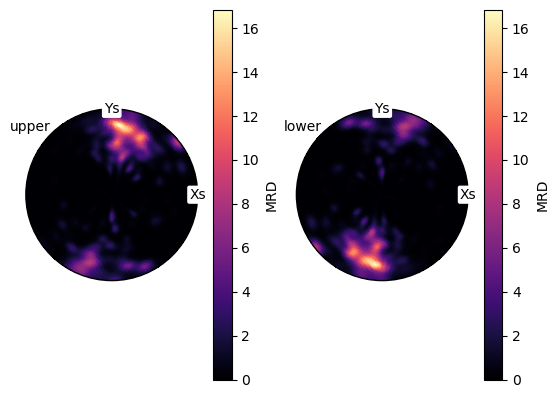

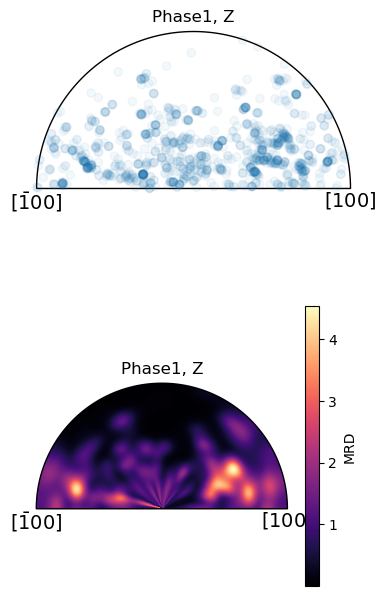

In [66]:
ebsdfile.ipf(df)